In [1]:
%load_ext autoreload
%autoreload 2
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = 'all'

import sys, os, gc
import numpy as np
import cv2
import torch
import moviepy.editor as mpy

current_path = rf"{os.getcwd()}"
main_path = os.path.abspath(os.path.dirname(current_path))
sys.path.append(rf"{main_path}")
sys.path.append(rf"{main_path}/src")

import utilities as util
from main import an_inference_engine, video_ad_model_inference_engine, an_ad_offline_result_presenter, cfg

output_dir = cfg.result_path
output_dir
output_dirpath = util.Path(rf"{main_path}/{output_dir}")
output_dirpath.mkdir(exist_ok=True, parents=True)

timer = util.ProcTimer()
timer.display_proctime()
timer.stop()

device = 'cuda' if torch.cuda.is_available() else 'cpu'

%matplotlib inline

process time: 0.0 seconds.


# Image Anonymization

In [2]:
# Configurations
cfg.anony_method_options_list
cfg.object_detection_classname_list
cfg.object_detection_imgsz
cfg.object_detection_thr

['no-an',
 'mask',
 'edge',
 'blur',
 'adaptive_blur',
 'adaptive_full_blur',
 'adaptive_max_blur',
 'pixelization',
 'adaptive_pixelization',
 'adaptive_max_pixelization']

['person', 'cell phone', 'laptop', 'tv']

(320, 240)

0.15

loading image file...
input image size: (2332, 3499, 3)
input image resize: (240, 320, 3)


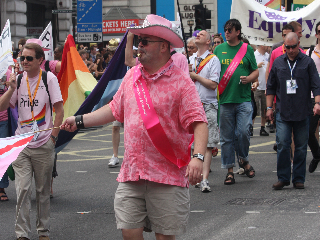

In [3]:
## Load image
img_path = rf"{main_path}/data/VISPR/2017_17368641.jpg"
img_bgr = util.load_image(img_path, img_size=cfg.object_detection_imgsz)
util.Image.fromarray(util.cv2.cvtColor(img_bgr, util.cv2.COLOR_BGR2RGB))

## Single AN [MASKED] Inference

In [4]:
# Load and setup AN method
anony_method = "mask"
object_detection_classes = ['person']
kwargs_detector_method = {"classes":[cfg.object_detection_classid_mapper_dict[classname] for classname in object_detection_classes], 
                              "detection_thr":cfg.object_detection_thr, 
                              "imgsz":cfg.object_detection_imgsz,
                              "device":"cuda"}
kwargs_anony_method = {"color_format":"bgr"}
axisANObj = an_inference_engine(anony_method, 
                                object_detection_classes=['person'],
                                kwargs_detector_method=kwargs_detector_method,
                                kwargs_anony_method=kwargs_anony_method)

init_anonymizer...
{'detector_name': 'body__yolo', 'kwargs_anony_method': {'color_format': 'bgr', 'alpha': 1.0, 'color': '#000000', 'preprocessors_list': [], 'postprocessors_list': []}, 'kwargs_detector_method': {'seg_type': 'instant', 'detector_version': 'yolov8m-seg.pt', 'detection_thr': 0.15, 'classes': [0], 'imgsz': (320, 240), 'device': 'cuda'}, 'target_resolution': None, 'isreset_cache': False}
loading object detector...
{'anony_type': 'body', 'seg_type': 'instant', 'detector_version': 'yolov8m-seg.pt', 'detection_thr': 0.15, 'classes': [0], 'imgsz': (320, 240), 'device': 'cuda'}
##############################
model:  yolov8m-seg.pt
{'method': <function ConventionalImageAnonymizer.silhoutte at 0x0000028499655C60>, 'kwargs': {'color_format': 'bgr', 'alpha': 1.0, 'color': '#000000', 'preprocessors_list': [], 'postprocessors_list': []}}


In [5]:
# AN inference
print("AN inference...")
an_success, an_img = axisANObj.inference(img_bgr)

AN inference...


100%|██████████| 1/1 [00:01<00:00,  1.05s/it]


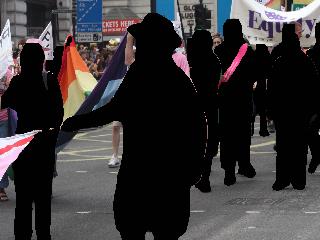

In [6]:
# Display the anonymized image
an_img_rgb = util.Image.fromarray(util.cv2.cvtColor(an_img, util.cv2.COLOR_BGR2RGB))
an_img_rgb

In [7]:
# Save the anonymized image
filename = ".".join(util.Path(img_path).name.split(".")[:-1])
result_filename_template = f'{anony_method}_imwh{an_img.shape[1]}x{an_img.shape[0]}_{filename}'
output_filepath = rf"{output_dirpath}/{result_filename_template}_an.jpg"
print("saving image to ", output_filepath)
an_img_rgb.save(output_filepath)

saving image to  c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/mask_imwh320x240_2017_17368641_an.jpg


## All AN Methods

All AN Methods: ['no-an', 'mask', 'edge', 'blur', 'adaptive_blur', 'adaptive_full_blur', 'adaptive_max_blur', 'pixelization', 'adaptive_pixelization', 'adaptive_max_pixelization']
Processing with anonymization method: no-an
init_anonymizer...
{'detector_name': 'image', 'kwargs_anony_method': {'color_format': 'bgr', 'preprocessors_list': [], 'postprocessors_list': [], 'alpha_mask_scale': 1.0, 'alpha_dim_scale': 0.5}, 'kwargs_detector_method': {'seg_type': 'instant', 'detector_version': 'yolov8m-seg.pt', 'detection_thr': 0.15, 'classes': [0], 'imgsz': (320, 240), 'device': 'cuda'}, 'target_resolution': None, 'isreset_cache': False}
Undefined anonymize method: raw. Thus, enforcing using raw footage.
{'method': None, 'kwargs': {}}
AN inference...


100%|██████████| 1/1 [00:00<?, ?it/s]


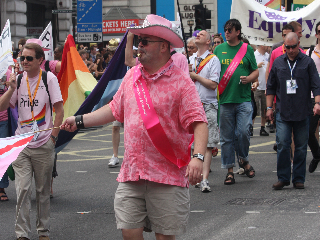

saving image to  c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/no-an_imwh320x240_2017_17368641_an.jpg
Processing with anonymization method: mask
init_anonymizer...
{'detector_name': 'body__yolo', 'kwargs_anony_method': {'color_format': 'bgr', 'alpha': 1.0, 'color': '#000000', 'preprocessors_list': [], 'postprocessors_list': [], 'alpha_mask_scale': 1.0, 'alpha_dim_scale': 0.5}, 'kwargs_detector_method': {'seg_type': 'instant', 'detector_version': 'yolov8m-seg.pt', 'detection_thr': 0.15, 'classes': [0], 'imgsz': (320, 240), 'device': 'cuda'}, 'target_resolution': None, 'isreset_cache': False}
loading object detector...
{'anony_type': 'body', 'seg_type': 'instant', 'detector_version': 'yolov8m-seg.pt', 'detection_thr': 0.15, 'classes': [0], 'imgsz': (320, 240), 'device': 'cuda'}
##############################
model:  yolov8m-seg.pt
{'method': <function ConventionalImageAnonymizer.silhoutte at 0x0000028499655C60>, 'kwargs': {'color_format': 'bgr'

100%|██████████| 1/1 [00:00<00:00,  3.20it/s]


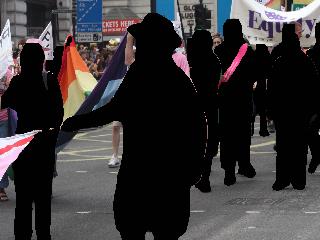

saving image to  c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/mask_imwh320x240_2017_17368641_an.jpg
Processing with anonymization method: edge
init_anonymizer...
{'detector_name': 'body__yolo', 'kwargs_anony_method': {'color_format': 'bgr', 'thr1': 100, 'thr2': 200, 'preprocessors_list': [], 'postprocessors_list': [], 'alpha_mask_scale': 1.0, 'alpha_dim_scale': 0.5}, 'kwargs_detector_method': {'seg_type': 'instant', 'detector_version': 'yolov8m-seg.pt', 'detection_thr': 0.15, 'classes': [0], 'imgsz': (320, 240), 'device': 'cuda'}, 'target_resolution': None, 'isreset_cache': False}
loading object detector...
{'anony_type': 'body', 'seg_type': 'instant', 'detector_version': 'yolov8m-seg.pt', 'detection_thr': 0.15, 'classes': [0], 'imgsz': (320, 240), 'device': 'cuda'}
##############################
model:  yolov8m-seg.pt
{'method': <function ConventionalImageAnonymizer.edge at 0x0000028499655D00>, 'kwargs': {'thr1': 100, 'thr2': 200, 'color_fo

100%|██████████| 1/1 [00:00<00:00,  3.09it/s]


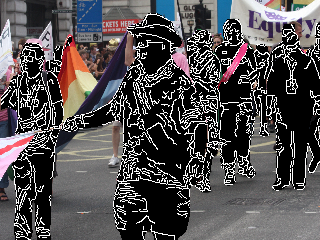

saving image to  c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/edge_imwh320x240_2017_17368641_an.jpg
Processing with anonymization method: blur
init_anonymizer...
{'detector_name': 'body__yolo', 'kwargs_anony_method': {'color_format': 'bgr', 'kernelsize': (13, 13), 'sigma': (10, 10), 'use_adaptive_mask': False, 'preprocessors_list': [], 'postprocessors_list': [], 'alpha_mask_scale': 1.0, 'alpha_dim_scale': 0.5}, 'kwargs_detector_method': {'seg_type': 'instant', 'detector_version': 'yolov8m-seg.pt', 'detection_thr': 0.15, 'classes': [0], 'imgsz': (320, 240), 'device': 'cuda'}, 'target_resolution': None, 'isreset_cache': False}
loading object detector...
{'anony_type': 'body', 'seg_type': 'instant', 'detector_version': 'yolov8m-seg.pt', 'detection_thr': 0.15, 'classes': [0], 'imgsz': (320, 240), 'device': 'cuda'}
##############################
model:  yolov8m-seg.pt
{'method': <function ConventionalImageAnonymizer.guassian_blur at 0x00000284996

100%|██████████| 1/1 [00:00<00:00,  4.07it/s]


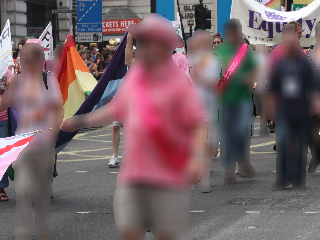

saving image to  c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/blur_imwh320x240_2017_17368641_an.jpg
Processing with anonymization method: adaptive_blur
init_anonymizer...
{'detector_name': 'body__yolo', 'kwargs_anony_method': {'color_format': 'bgr', 'kernelsize': (13, 13), 'sigma': (10, 10), 'use_adaptive_mask': True, 'adaptive_sigma': False, 'alpha_mask_scale': 1.0, 'alpha_dim_scale': 0.5, 'use_log_scaler': True, 'preprocessors_list': [], 'postprocessors_list': []}, 'kwargs_detector_method': {'seg_type': 'instant', 'detector_version': 'yolov8m-seg.pt', 'detection_thr': 0.15, 'classes': [0], 'imgsz': (320, 240), 'device': 'cuda'}, 'target_resolution': None, 'isreset_cache': False}
loading object detector...
{'anony_type': 'body', 'seg_type': 'instant', 'detector_version': 'yolov8m-seg.pt', 'detection_thr': 0.15, 'classes': [0], 'imgsz': (320, 240), 'device': 'cuda'}
##############################
model:  yolov8m-seg.pt
{'method': <function C

100%|██████████| 1/1 [00:00<00:00,  3.48it/s]


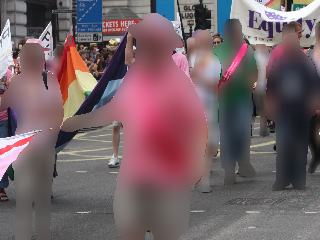

saving image to  c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/adaptive_blur_imwh320x240_2017_17368641_an.jpg
Processing with anonymization method: adaptive_full_blur
init_anonymizer...
{'detector_name': 'body__yolo', 'kwargs_anony_method': {'color_format': 'bgr', 'kernelsize': (13, 13), 'sigma': (10, 10), 'use_adaptive_mask': True, 'adaptive_sigma': True, 'alpha_mask_scale': 1.0, 'alpha_dim_scale': 0.5, 'use_log_scaler': True, 'preprocessors_list': [], 'postprocessors_list': []}, 'kwargs_detector_method': {'seg_type': 'instant', 'detector_version': 'yolov8m-seg.pt', 'detection_thr': 0.15, 'classes': [0], 'imgsz': (320, 240), 'device': 'cuda'}, 'target_resolution': None, 'isreset_cache': False}
loading object detector...
{'anony_type': 'body', 'seg_type': 'instant', 'detector_version': 'yolov8m-seg.pt', 'detection_thr': 0.15, 'classes': [0], 'imgsz': (320, 240), 'device': 'cuda'}
##############################
model:  yolov8m-seg.pt
{'method'

100%|██████████| 1/1 [00:00<00:00,  3.14it/s]


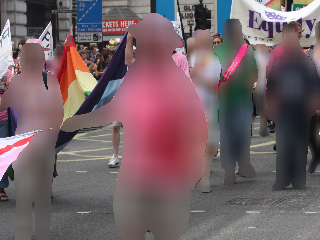

saving image to  c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/adaptive_full_blur_imwh320x240_2017_17368641_an.jpg
Processing with anonymization method: adaptive_max_blur
init_anonymizer...
{'detector_name': 'body__yolo', 'kwargs_anony_method': {'color_format': 'bgr', 'kernelsize': (0, 0), 'sigma': (0, 0), 'use_adaptive_mask': True, 'preprocessors_list': [], 'postprocessors_list': [], 'alpha_mask_scale': 1.0, 'alpha_dim_scale': 0.5}, 'kwargs_detector_method': {'seg_type': 'instant', 'detector_version': 'yolov8m-seg.pt', 'detection_thr': 0.15, 'classes': [0], 'imgsz': (320, 240), 'device': 'cuda'}, 'target_resolution': None, 'isreset_cache': False}
loading object detector...
{'anony_type': 'body', 'seg_type': 'instant', 'detector_version': 'yolov8m-seg.pt', 'detection_thr': 0.15, 'classes': [0], 'imgsz': (320, 240), 'device': 'cuda'}
##############################
model:  yolov8m-seg.pt
{'method': <function ConventionalImageAnonymizer.guassian

100%|██████████| 1/1 [00:00<00:00,  2.87it/s]


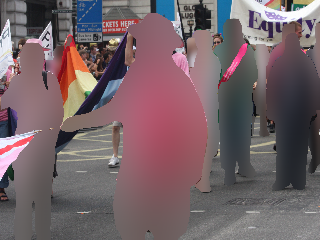

saving image to  c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/adaptive_max_blur_imwh320x240_2017_17368641_an.jpg
Processing with anonymization method: pixelization
init_anonymizer...
{'detector_name': 'body__yolo', 'kwargs_anony_method': {'color_format': 'bgr', 'downsize': 4, 'use_adaptive_mask': False, 'preprocessors_list': [], 'postprocessors_list': [], 'alpha_mask_scale': 1.0, 'alpha_dim_scale': 0.5}, 'kwargs_detector_method': {'seg_type': 'instant', 'detector_version': 'yolov8m-seg.pt', 'detection_thr': 0.15, 'classes': [0], 'imgsz': (320, 240), 'device': 'cuda'}, 'target_resolution': None, 'isreset_cache': False}
loading object detector...
{'anony_type': 'body', 'seg_type': 'instant', 'detector_version': 'yolov8m-seg.pt', 'detection_thr': 0.15, 'classes': [0], 'imgsz': (320, 240), 'device': 'cuda'}
##############################
model:  yolov8m-seg.pt
{'method': <function ConventionalImageAnonymizer.pixelization at 0x0000028499655E40>, 

100%|██████████| 1/1 [00:00<00:00,  2.91it/s]


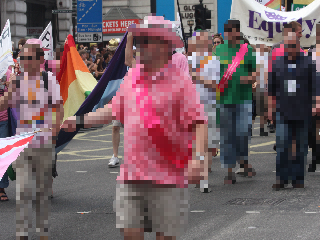

saving image to  c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/pixelization_imwh320x240_2017_17368641_an.jpg
Processing with anonymization method: adaptive_pixelization
init_anonymizer...
{'detector_name': 'body__yolo', 'kwargs_anony_method': {'color_format': 'bgr', 'downsize': 4, 'use_adaptive_mask': True, 'alpha_mask_scale': 1.0, 'alpha_dim_scale': 0.5, 'use_log_scaler': True, 'preprocessors_list': [], 'postprocessors_list': []}, 'kwargs_detector_method': {'seg_type': 'instant', 'detector_version': 'yolov8m-seg.pt', 'detection_thr': 0.15, 'classes': [0], 'imgsz': (320, 240), 'device': 'cuda'}, 'target_resolution': None, 'isreset_cache': False}
loading object detector...
{'anony_type': 'body', 'seg_type': 'instant', 'detector_version': 'yolov8m-seg.pt', 'detection_thr': 0.15, 'classes': [0], 'imgsz': (320, 240), 'device': 'cuda'}
##############################
model:  yolov8m-seg.pt
{'method': <function ConventionalImageAnonymizer.pixelizati

100%|██████████| 1/1 [00:00<00:00,  3.42it/s]


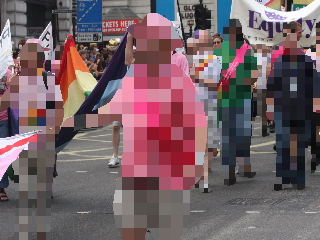

saving image to  c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/adaptive_pixelization_imwh320x240_2017_17368641_an.jpg
Processing with anonymization method: adaptive_max_pixelization
init_anonymizer...
{'detector_name': 'body__yolo', 'kwargs_anony_method': {'color_format': 'bgr', 'downsize': 0, 'use_adaptive_mask': True, 'preprocessors_list': [], 'postprocessors_list': [], 'alpha_mask_scale': 1.0, 'alpha_dim_scale': 0.5}, 'kwargs_detector_method': {'seg_type': 'instant', 'detector_version': 'yolov8m-seg.pt', 'detection_thr': 0.15, 'classes': [0], 'imgsz': (320, 240), 'device': 'cuda'}, 'target_resolution': None, 'isreset_cache': False}
loading object detector...
{'anony_type': 'body', 'seg_type': 'instant', 'detector_version': 'yolov8m-seg.pt', 'detection_thr': 0.15, 'classes': [0], 'imgsz': (320, 240), 'device': 'cuda'}
##############################
model:  yolov8m-seg.pt
{'method': <function ConventionalImageAnonymizer.pixelization at 0x000

100%|██████████| 1/1 [00:00<00:00,  3.21it/s]


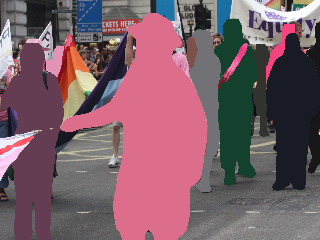

saving image to  c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/adaptive_max_pixelization_imwh320x240_2017_17368641_an.jpg


In [8]:
# General setup for AN inference
object_detection_classes = ['person']
kwargs_detector_method = {"classes":[cfg.object_detection_classid_mapper_dict[classname] for classname in object_detection_classes], 
                              "detection_thr":cfg.object_detection_thr, 
                              "imgsz":cfg.object_detection_imgsz,
                              "device":"cuda"}
kwargs_anony_method = {"alpha_mask_scale":1.0, "alpha_dim_scale":0.5, "color_format":"bgr"}

# output filename extraction
filename = ".".join(util.Path(img_path).name.split(".")[:-1])

# Iterate through all anonymization methods
print("All AN Methods:", cfg.anony_method_options_list)

for anony_method in cfg.anony_method_options_list:
    print(f"Processing with anonymization method: {anony_method}")
    axisANObj = an_inference_engine(anony_method, 
                                object_detection_classes=['person'],
                                kwargs_detector_method=kwargs_detector_method,
                                kwargs_anony_method=kwargs_anony_method)
    
    # AN inference
    print("AN inference...")
    an_success, an_img = axisANObj.inference(img_bgr)
        
    # Display the anonymized image
    an_img_rgb = util.Image.fromarray(util.cv2.cvtColor(an_img, util.cv2.COLOR_BGR2RGB))
    an_img_rgb

    # Save the anonymized image
    result_filename_template = f'{anony_method}_imwh{an_img.shape[1]}x{an_img.shape[0]}_{filename}'
    output_dirpath = util.Path(rf"{main_path}/{output_dir}")
    output_dirpath.mkdir(exist_ok=True, parents=True)
    output_filepath = rf"{output_dirpath}/{result_filename_template}_an.jpg"
    print("saving image to ", output_filepath)
    an_img_rgb.save(output_filepath)

    # break

# Video Anonymization and Anomaly Detection

In [9]:
# Configurations
cfg.anony_method_options_list
cfg.object_detection_classname_list
cfg.object_detection_imgsz
cfg.object_detection_thr

cfg.ad_method_options_list
cfg.ad_model_src
cfg.ad_thr

['no-an',
 'mask',
 'edge',
 'blur',
 'adaptive_blur',
 'adaptive_full_blur',
 'adaptive_max_blur',
 'pixelization',
 'adaptive_pixelization',
 'adaptive_max_pixelization']

['person', 'cell phone', 'laptop', 'tv']

(320, 240)

0.15

['pel', 'mgfn']

'xd'

0.5

In [10]:
# Load video file
vid_path = rf"{main_path}/data/UCF_Crime/Burglary033_x264.mp4"
video_frames, video_meta = util.videofile_loader(vid_path, start_sec=0, clip_duration=None, fps=None, target_resolution=[240, 320])
print("video_meta: ", video_meta)
mpyVidObj = mpy.ImageSequenceClip(list(map(lambda x: cv2.cvtColor(x, cv2.COLOR_BGR2RGB).astype("uint8"), video_frames)), fps=video_meta["fps"])
mpyVidObj.ipython_display(width=480, height=360, fps=video_meta["fps"], maxduration=video_meta["duration"]+1, autoplay=True)

videofile_loader...
process time: 0.97375 seconds.
loaded frame duration: 42.03 secs, frame length: 1261, fps: 30, resolution: (240, 320, 3)
video_meta:  {'num_frames': 1261, 'fps': 30, 'duration': 42.03, 'frame_size': (240, 320, 3)}
Moviepy - Building video __temp__.mp4.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


## Single AN-VAD Method Inference [MASKED - PEL4VAD]

In [11]:
# Load and setup AN method
anony_method = "mask"
object_detection_classes = ['person']
kwargs_detector_method = {"classes":[cfg.object_detection_classid_mapper_dict[classname] for classname in object_detection_classes], 
                              "detection_thr":cfg.object_detection_thr, 
                              "imgsz":cfg.object_detection_imgsz,
                              "device":"cuda"}
kwargs_anony_method = {"color_format":"bgr"}
axisANObj = an_inference_engine(anony_method, 
                                object_detection_classes = ['person'],
                                kwargs_detector_method=kwargs_detector_method,
                                kwargs_anony_method=kwargs_anony_method)

# Load and setup VAD method
ad_method = cfg.ad_method_options_list[0]
ad_model_src = "ucf"
ad_thr = 0.5
kwargs_ad_method = {"ad_model_src":ad_model_src, "ad_thr":ad_thr}
axisADObj = video_ad_model_inference_engine(ad_method=ad_method, kwargs_ad_method=kwargs_ad_method)

init_anonymizer...
{'detector_name': 'body__yolo', 'kwargs_anony_method': {'color_format': 'bgr', 'alpha': 1.0, 'color': '#000000', 'preprocessors_list': [], 'postprocessors_list': []}, 'kwargs_detector_method': {'seg_type': 'instant', 'detector_version': 'yolov8m-seg.pt', 'detection_thr': 0.15, 'classes': [0], 'imgsz': (320, 240), 'device': 'cuda'}, 'target_resolution': None, 'isreset_cache': False}
loading object detector...
{'anony_type': 'body', 'seg_type': 'instant', 'detector_version': 'yolov8m-seg.pt', 'detection_thr': 0.15, 'classes': [0], 'imgsz': (320, 240), 'device': 'cuda'}
##############################
model:  yolov8m-seg.pt
{'method': <function ConventionalImageAnonymizer.silhoutte at 0x0000028499655C60>, 'kwargs': {'color_format': 'bgr', 'alpha': 1.0, 'color': '#000000', 'preprocessors_list': [], 'postprocessors_list': []}}
dataset:  ucf
loading pretrained checkpoint from c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\src\model\PEL4VAD

AN-VAD inference...
AN inference...


100%|██████████| 1261/1261 [00:20<00:00, 61.03it/s]


AN: 20.663 secs
AD inference...
VAD Inference...
extracting features...
run...device: cuda, batch_size: 20...
frame_cnt: 1261
frame_indices:  4, batch_num: 4


100%|██████████| 4/4 [00:17<00:00,  4.34s/it]


obtained features of size:  (78, 10, 1024)
done in 17.45158290863037 sec, features shape: (78, 10, 1025).
AD: 17.519 secs


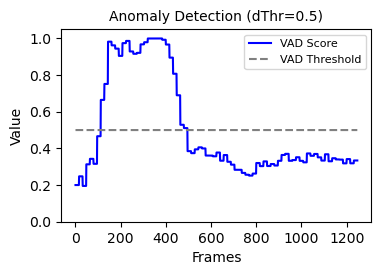

In [12]:
# AN-VAD inference
print("AN-VAD inference...")
ad_score_fig, an_ad_frame_list = an_ad_offline_result_presenter(axisANObj, axisADObj, video_frames)

In [13]:
# Display the AN-VAD video
mpyVidObj = mpy.ImageSequenceClip(an_ad_frame_list, fps=video_meta["fps"])
mpyVidObj.ipython_display(width=480, height=360, fps=video_meta["fps"], maxduration=video_meta["duration"]+1, autoplay=True)

Moviepy - Building video __temp__.mp4.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


In [14]:
# Save the anonymized video and VAD score figure
filename = ".".join(util.Path(vid_path).name.split(".")[:-1])
frame_size = video_frames[0].shape[:2]  # (width, height)
result_filename_template = f'{ad_method}_{ad_model_src}_{anony_method}_imwh{frame_size[1]}x{frame_size[0]}_{filename}'
if ad_score_fig is not None:
    util.save_figure(ad_score_fig, f'{result_filename_template}_ad', output_dirpath, dpi=100, format="jpg", issave=True, isshow=False)
if an_ad_frame_list is not None:
    util.save_video(an_ad_frame_list, video_meta["fps"], rf'{result_filename_template}_ad', output_dirpath)

saving to  c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results
saving video to  c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/pel_ucf_mask_imwh320x240_Burglary033_x264_ad.mp4
Moviepy - Building video c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/pel_ucf_mask_imwh320x240_Burglary033_x264_ad.mp4.
Moviepy - Writing video c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/pel_ucf_mask_imwh320x240_Burglary033_x264_ad.mp4



Moviepy - Done !
Moviepy - video ready c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/pel_ucf_mask_imwh320x240_Burglary033_x264_ad.mp4


## UCF-Crime Dataset Example

In [15]:
# Load video file
vid_path = rf"{main_path}/data/UCF_Crime/Burglary033_x264.mp4"
video_frames, video_meta = util.videofile_loader(vid_path, start_sec=0, clip_duration=None, fps=None, target_resolution=None)
print("video_meta: ", video_meta)
mpyVidObj = mpy.ImageSequenceClip(list(map(lambda x: cv2.cvtColor(x, cv2.COLOR_BGR2RGB).astype("uint8"), video_frames)), fps=video_meta["fps"])
mpyVidObj.ipython_display(width=480, height=360, fps=video_meta["fps"], maxduration=video_meta["duration"]+1, autoplay=True)

videofile_loader...
process time: 1.0472 seconds.
loaded frame duration: 42.03 secs, frame length: 1261, fps: 30, resolution: (240, 320, 3)
video_meta:  {'num_frames': 1261, 'fps': 30, 'duration': 42.03, 'frame_size': (240, 320, 3)}
Moviepy - Building video __temp__.mp4.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


### All AN Methods with VAD-PEL4VAD

dataset:  ucf
loading pretrained checkpoint from c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\src\model\PEL4VAD/ckpt/ucf__8636.pkl.
dataset:  ucf
VideoFeatureExtractor: feature_dim=1024, pretrainedpath=c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\src\model/VIDEO_ENCODER_RESNET_1024/models/i3d/ckpt/i3d_rgb.pt
{'frequency': 16, 'sample_T': 10}
All AN Methods: ['no-an', 'mask', 'edge', 'blur', 'adaptive_blur', 'adaptive_full_blur', 'adaptive_max_blur', 'pixelization', 'adaptive_pixelization', 'adaptive_max_pixelization']
####################################################################################################
Processing with anonymization method: NO-AN
####################################################################################################
init_anonymizer...
{'detector_name': 'image', 'kwargs_anony_method': {'color_format': 'bgr', 'preprocessors_list': [], 'postprocessors_list': [], 'alpha_mas

100%|██████████| 1261/1261 [00:00<00:00, 1172471.15it/s]


AN: 0.004 secs
AD inference...
VAD Inference...
extracting features...
run...device: cuda, batch_size: 20...
frame_cnt: 1261
frame_indices:  4, batch_num: 4


100%|██████████| 4/4 [00:17<00:00,  4.49s/it]


obtained features of size:  (78, 10, 1024)
done in 18.100109815597534 sec, features shape: (78, 10, 1025).
AD: 18.113 secs


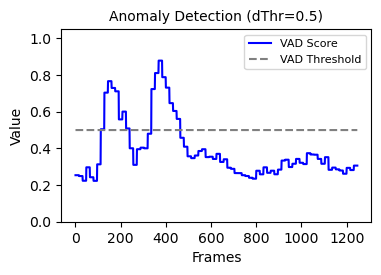

Moviepy - Building video __temp__.mp4.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


saving to  c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results
saving video to  c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/pel_ucf_no-an_imwh320x240_Burglary033_x264_ad.mp4
Moviepy - Building video c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/pel_ucf_no-an_imwh320x240_Burglary033_x264_ad.mp4.
Moviepy - Writing video c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/pel_ucf_no-an_imwh320x240_Burglary033_x264_ad.mp4



Moviepy - Done !
Moviepy - video ready c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/pel_ucf_no-an_imwh320x240_Burglary033_x264_ad.mp4
Processing completed for method: no-an


16470

##################################################
####################################################################################################
Processing with anonymization method: MASK
####################################################################################################
init_anonymizer...
{'detector_name': 'body__yolo', 'kwargs_anony_method': {'color_format': 'bgr', 'alpha': 1.0, 'color': '#000000', 'preprocessors_list': [], 'postprocessors_list': [], 'alpha_mask_scale': 1.0, 'alpha_dim_scale': 0.5}, 'kwargs_detector_method': {'seg_type': 'instant', 'detector_version': 'yolov8m-seg.pt', 'detection_thr': 0.15, 'classes': [0], 'imgsz': (320, 240), 'device': 'cuda'}, 'target_resolution': None, 'isreset_cache': False}
loading object detector...
{'anony_type': 'body', 'seg_type': 'instant', 'detector_version': 'yolov8m-seg.pt', 'detection_thr': 0.15, 'classes': [0], 'imgsz': (320, 240), 'device': 'cuda'}
##############################
model:  yolov8m-seg.pt
{'method

100%|██████████| 1261/1261 [00:22<00:00, 55.80it/s]


AN: 22.602 secs
AD inference...
VAD Inference...
extracting features...
run...device: cuda, batch_size: 20...
frame_cnt: 1261
frame_indices:  4, batch_num: 4


100%|██████████| 4/4 [00:15<00:00,  3.93s/it]


obtained features of size:  (78, 10, 1024)
done in 15.82620906829834 sec, features shape: (78, 10, 1025).
AD: 15.835 secs


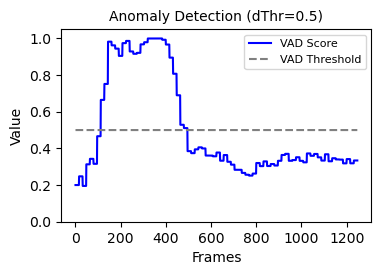

Moviepy - Building video __temp__.mp4.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


saving to  c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results
saving video to  c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/pel_ucf_mask_imwh320x240_Burglary033_x264_ad.mp4
Moviepy - Building video c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/pel_ucf_mask_imwh320x240_Burglary033_x264_ad.mp4.
Moviepy - Writing video c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/pel_ucf_mask_imwh320x240_Burglary033_x264_ad.mp4



Moviepy - Done !
Moviepy - video ready c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/pel_ucf_mask_imwh320x240_Burglary033_x264_ad.mp4
Processing completed for method: mask


54

##################################################
####################################################################################################
Processing with anonymization method: EDGE
####################################################################################################
init_anonymizer...
{'detector_name': 'body__yolo', 'kwargs_anony_method': {'color_format': 'bgr', 'thr1': 100, 'thr2': 200, 'preprocessors_list': [], 'postprocessors_list': [], 'alpha_mask_scale': 1.0, 'alpha_dim_scale': 0.5}, 'kwargs_detector_method': {'seg_type': 'instant', 'detector_version': 'yolov8m-seg.pt', 'detection_thr': 0.15, 'classes': [0], 'imgsz': (320, 240), 'device': 'cuda'}, 'target_resolution': None, 'isreset_cache': False}
loading object detector...
{'anony_type': 'body', 'seg_type': 'instant', 'detector_version': 'yolov8m-seg.pt', 'detection_thr': 0.15, 'classes': [0], 'imgsz': (320, 240), 'device': 'cuda'}
##############################
model:  yolov8m-seg.pt
{'method': <func

100%|██████████| 1261/1261 [00:20<00:00, 60.89it/s]


AN: 20.713 secs
AD inference...
VAD Inference...
extracting features...
run...device: cuda, batch_size: 20...
frame_cnt: 1261
frame_indices:  4, batch_num: 4


100%|██████████| 4/4 [00:16<00:00,  4.22s/it]


obtained features of size:  (78, 10, 1024)
done in 16.978265285491943 sec, features shape: (78, 10, 1025).
AD: 16.990 secs


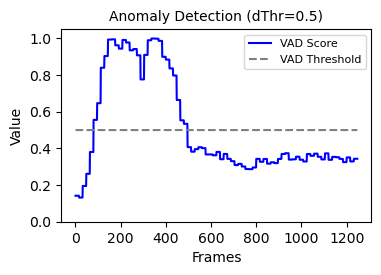

Moviepy - Building video __temp__.mp4.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


saving to  c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results
saving video to  c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/pel_ucf_edge_imwh320x240_Burglary033_x264_ad.mp4
Moviepy - Building video c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/pel_ucf_edge_imwh320x240_Burglary033_x264_ad.mp4.
Moviepy - Writing video c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/pel_ucf_edge_imwh320x240_Burglary033_x264_ad.mp4



Moviepy - Done !
Moviepy - video ready c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/pel_ucf_edge_imwh320x240_Burglary033_x264_ad.mp4
Processing completed for method: edge


4428

##################################################
####################################################################################################
Processing with anonymization method: BLUR
####################################################################################################
init_anonymizer...
{'detector_name': 'body__yolo', 'kwargs_anony_method': {'color_format': 'bgr', 'kernelsize': (13, 13), 'sigma': (10, 10), 'use_adaptive_mask': False, 'preprocessors_list': [], 'postprocessors_list': [], 'alpha_mask_scale': 1.0, 'alpha_dim_scale': 0.5}, 'kwargs_detector_method': {'seg_type': 'instant', 'detector_version': 'yolov8m-seg.pt', 'detection_thr': 0.15, 'classes': [0], 'imgsz': (320, 240), 'device': 'cuda'}, 'target_resolution': None, 'isreset_cache': False}
loading object detector...
{'anony_type': 'body', 'seg_type': 'instant', 'detector_version': 'yolov8m-seg.pt', 'detection_thr': 0.15, 'classes': [0], 'imgsz': (320, 240), 'device': 'cuda'}
#########################

100%|██████████| 1261/1261 [00:23<00:00, 54.08it/s]


AN: 23.320 secs
AD inference...
VAD Inference...
extracting features...
run...device: cuda, batch_size: 20...
frame_cnt: 1261
frame_indices:  4, batch_num: 4


100%|██████████| 4/4 [00:18<00:00,  4.69s/it]


obtained features of size:  (78, 10, 1024)
done in 18.853079795837402 sec, features shape: (78, 10, 1025).
AD: 18.864 secs


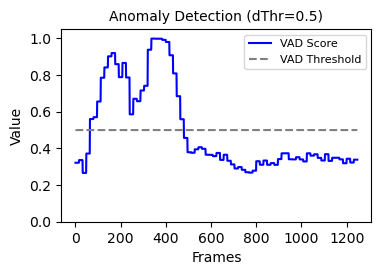

Moviepy - Building video __temp__.mp4.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


saving to  c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results
saving video to  c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/pel_ucf_blur_imwh320x240_Burglary033_x264_ad.mp4
Moviepy - Building video c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/pel_ucf_blur_imwh320x240_Burglary033_x264_ad.mp4.
Moviepy - Writing video c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/pel_ucf_blur_imwh320x240_Burglary033_x264_ad.mp4



Moviepy - Done !
Moviepy - video ready c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/pel_ucf_blur_imwh320x240_Burglary033_x264_ad.mp4
Processing completed for method: blur


4428

##################################################
####################################################################################################
Processing with anonymization method: ADAPTIVE_BLUR
####################################################################################################
init_anonymizer...
{'detector_name': 'body__yolo', 'kwargs_anony_method': {'color_format': 'bgr', 'kernelsize': (13, 13), 'sigma': (10, 10), 'use_adaptive_mask': True, 'adaptive_sigma': False, 'alpha_mask_scale': 1.0, 'alpha_dim_scale': 0.5, 'use_log_scaler': True, 'preprocessors_list': [], 'postprocessors_list': []}, 'kwargs_detector_method': {'seg_type': 'instant', 'detector_version': 'yolov8m-seg.pt', 'detection_thr': 0.15, 'classes': [0], 'imgsz': (320, 240), 'device': 'cuda'}, 'target_resolution': None, 'isreset_cache': False}
loading object detector...
{'anony_type': 'body', 'seg_type': 'instant', 'detector_version': 'yolov8m-seg.pt', 'detection_thr': 0.15, 'classes': [0], 'imgsz'

100%|██████████| 1261/1261 [00:23<00:00, 54.69it/s]


AN: 23.061 secs
AD inference...
VAD Inference...
extracting features...
run...device: cuda, batch_size: 20...
frame_cnt: 1261
frame_indices:  4, batch_num: 4


100%|██████████| 4/4 [00:18<00:00,  4.52s/it]


obtained features of size:  (78, 10, 1024)
done in 18.217960596084595 sec, features shape: (78, 10, 1025).
AD: 18.224 secs


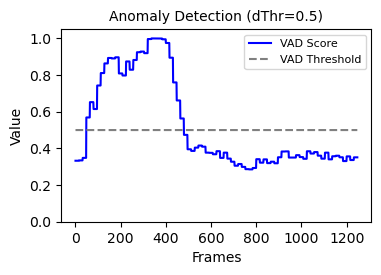

Moviepy - Building video __temp__.mp4.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


saving to  c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results
saving video to  c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/pel_ucf_adaptive_blur_imwh320x240_Burglary033_x264_ad.mp4
Moviepy - Building video c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/pel_ucf_adaptive_blur_imwh320x240_Burglary033_x264_ad.mp4.
Moviepy - Writing video c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/pel_ucf_adaptive_blur_imwh320x240_Burglary033_x264_ad.mp4



Moviepy - Done !
Moviepy - video ready c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/pel_ucf_adaptive_blur_imwh320x240_Burglary033_x264_ad.mp4
Processing completed for method: adaptive_blur


4428

##################################################
####################################################################################################
Processing with anonymization method: ADAPTIVE_FULL_BLUR
####################################################################################################
init_anonymizer...
{'detector_name': 'body__yolo', 'kwargs_anony_method': {'color_format': 'bgr', 'kernelsize': (13, 13), 'sigma': (10, 10), 'use_adaptive_mask': True, 'adaptive_sigma': True, 'alpha_mask_scale': 1.0, 'alpha_dim_scale': 0.5, 'use_log_scaler': True, 'preprocessors_list': [], 'postprocessors_list': []}, 'kwargs_detector_method': {'seg_type': 'instant', 'detector_version': 'yolov8m-seg.pt', 'detection_thr': 0.15, 'classes': [0], 'imgsz': (320, 240), 'device': 'cuda'}, 'target_resolution': None, 'isreset_cache': False}
loading object detector...
{'anony_type': 'body', 'seg_type': 'instant', 'detector_version': 'yolov8m-seg.pt', 'detection_thr': 0.15, 'classes': [0], 'im

100%|██████████| 1261/1261 [00:22<00:00, 55.06it/s]


AN: 22.903 secs
AD inference...
VAD Inference...
extracting features...
run...device: cuda, batch_size: 20...
frame_cnt: 1261
frame_indices:  4, batch_num: 4


100%|██████████| 4/4 [00:18<00:00,  4.64s/it]


obtained features of size:  (78, 10, 1024)
done in 18.750767469406128 sec, features shape: (78, 10, 1025).
AD: 18.772 secs


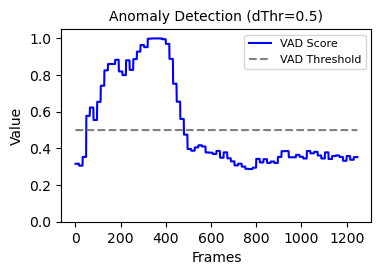

Moviepy - Building video __temp__.mp4.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


saving to  c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results
saving video to  c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/pel_ucf_adaptive_full_blur_imwh320x240_Burglary033_x264_ad.mp4
Moviepy - Building video c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/pel_ucf_adaptive_full_blur_imwh320x240_Burglary033_x264_ad.mp4.
Moviepy - Writing video c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/pel_ucf_adaptive_full_blur_imwh320x240_Burglary033_x264_ad.mp4



Moviepy - Done !
Moviepy - video ready c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/pel_ucf_adaptive_full_blur_imwh320x240_Burglary033_x264_ad.mp4
Processing completed for method: adaptive_full_blur


4428

##################################################
####################################################################################################
Processing with anonymization method: ADAPTIVE_MAX_BLUR
####################################################################################################
init_anonymizer...
{'detector_name': 'body__yolo', 'kwargs_anony_method': {'color_format': 'bgr', 'kernelsize': (0, 0), 'sigma': (0, 0), 'use_adaptive_mask': True, 'preprocessors_list': [], 'postprocessors_list': [], 'alpha_mask_scale': 1.0, 'alpha_dim_scale': 0.5}, 'kwargs_detector_method': {'seg_type': 'instant', 'detector_version': 'yolov8m-seg.pt', 'detection_thr': 0.15, 'classes': [0], 'imgsz': (320, 240), 'device': 'cuda'}, 'target_resolution': None, 'isreset_cache': False}
loading object detector...
{'anony_type': 'body', 'seg_type': 'instant', 'detector_version': 'yolov8m-seg.pt', 'detection_thr': 0.15, 'classes': [0], 'imgsz': (320, 240), 'device': 'cuda'}
#################

100%|██████████| 1261/1261 [00:21<00:00, 57.93it/s]


AN: 21.768 secs
AD inference...
VAD Inference...
extracting features...
run...device: cuda, batch_size: 20...
frame_cnt: 1261
frame_indices:  4, batch_num: 4


100%|██████████| 4/4 [00:15<00:00,  3.77s/it]


obtained features of size:  (78, 10, 1024)
done in 15.152001142501831 sec, features shape: (78, 10, 1025).
AD: 15.154 secs


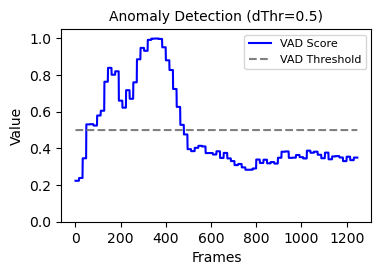

Moviepy - Building video __temp__.mp4.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


saving to  c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results
saving video to  c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/pel_ucf_adaptive_max_blur_imwh320x240_Burglary033_x264_ad.mp4
Moviepy - Building video c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/pel_ucf_adaptive_max_blur_imwh320x240_Burglary033_x264_ad.mp4.
Moviepy - Writing video c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/pel_ucf_adaptive_max_blur_imwh320x240_Burglary033_x264_ad.mp4



Moviepy - Done !
Moviepy - video ready c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/pel_ucf_adaptive_max_blur_imwh320x240_Burglary033_x264_ad.mp4
Processing completed for method: adaptive_max_blur


4428

##################################################
####################################################################################################
Processing with anonymization method: PIXELIZATION
####################################################################################################
init_anonymizer...
{'detector_name': 'body__yolo', 'kwargs_anony_method': {'color_format': 'bgr', 'downsize': 4, 'use_adaptive_mask': False, 'preprocessors_list': [], 'postprocessors_list': [], 'alpha_mask_scale': 1.0, 'alpha_dim_scale': 0.5}, 'kwargs_detector_method': {'seg_type': 'instant', 'detector_version': 'yolov8m-seg.pt', 'detection_thr': 0.15, 'classes': [0], 'imgsz': (320, 240), 'device': 'cuda'}, 'target_resolution': None, 'isreset_cache': False}
loading object detector...
{'anony_type': 'body', 'seg_type': 'instant', 'detector_version': 'yolov8m-seg.pt', 'detection_thr': 0.15, 'classes': [0], 'imgsz': (320, 240), 'device': 'cuda'}
##############################
model:  yolov8

100%|██████████| 1261/1261 [00:17<00:00, 70.90it/s]


AN: 17.786 secs
AD inference...
VAD Inference...
extracting features...
run...device: cuda, batch_size: 20...
frame_cnt: 1261
frame_indices:  4, batch_num: 4


100%|██████████| 4/4 [00:14<00:00,  3.66s/it]


obtained features of size:  (78, 10, 1024)
done in 14.708873987197876 sec, features shape: (78, 10, 1025).
AD: 14.709 secs


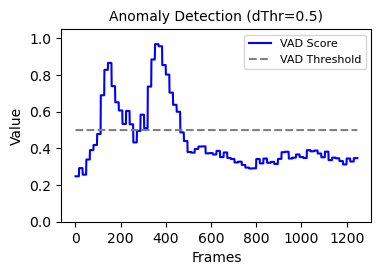

Moviepy - Building video __temp__.mp4.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


saving to  c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results
saving video to  c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/pel_ucf_pixelization_imwh320x240_Burglary033_x264_ad.mp4
Moviepy - Building video c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/pel_ucf_pixelization_imwh320x240_Burglary033_x264_ad.mp4.
Moviepy - Writing video c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/pel_ucf_pixelization_imwh320x240_Burglary033_x264_ad.mp4



Moviepy - Done !
Moviepy - video ready c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/pel_ucf_pixelization_imwh320x240_Burglary033_x264_ad.mp4
Processing completed for method: pixelization


4425

##################################################
####################################################################################################
Processing with anonymization method: ADAPTIVE_PIXELIZATION
####################################################################################################
init_anonymizer...
{'detector_name': 'body__yolo', 'kwargs_anony_method': {'color_format': 'bgr', 'downsize': 4, 'use_adaptive_mask': True, 'alpha_mask_scale': 1.0, 'alpha_dim_scale': 0.5, 'use_log_scaler': True, 'preprocessors_list': [], 'postprocessors_list': []}, 'kwargs_detector_method': {'seg_type': 'instant', 'detector_version': 'yolov8m-seg.pt', 'detection_thr': 0.15, 'classes': [0], 'imgsz': (320, 240), 'device': 'cuda'}, 'target_resolution': None, 'isreset_cache': False}
loading object detector...
{'anony_type': 'body', 'seg_type': 'instant', 'detector_version': 'yolov8m-seg.pt', 'detection_thr': 0.15, 'classes': [0], 'imgsz': (320, 240), 'device': 'cuda'}
#############

100%|██████████| 1261/1261 [00:18<00:00, 69.32it/s]


AN: 18.191 secs
AD inference...
VAD Inference...
extracting features...
run...device: cuda, batch_size: 20...
frame_cnt: 1261
frame_indices:  4, batch_num: 4


100%|██████████| 4/4 [00:16<00:00,  4.17s/it]


obtained features of size:  (78, 10, 1024)
done in 16.83530354499817 sec, features shape: (78, 10, 1025).
AD: 16.848 secs


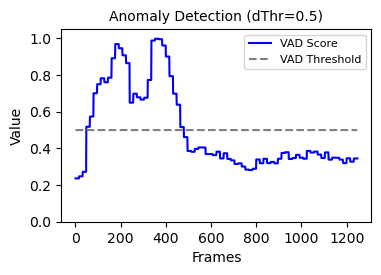

Moviepy - Building video __temp__.mp4.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


saving to  c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results
saving video to  c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/pel_ucf_adaptive_pixelization_imwh320x240_Burglary033_x264_ad.mp4
Moviepy - Building video c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/pel_ucf_adaptive_pixelization_imwh320x240_Burglary033_x264_ad.mp4.
Moviepy - Writing video c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/pel_ucf_adaptive_pixelization_imwh320x240_Burglary033_x264_ad.mp4



Moviepy - Done !
Moviepy - video ready c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/pel_ucf_adaptive_pixelization_imwh320x240_Burglary033_x264_ad.mp4
Processing completed for method: adaptive_pixelization


4428

##################################################
####################################################################################################
Processing with anonymization method: ADAPTIVE_MAX_PIXELIZATION
####################################################################################################
init_anonymizer...
{'detector_name': 'body__yolo', 'kwargs_anony_method': {'color_format': 'bgr', 'downsize': 0, 'use_adaptive_mask': True, 'preprocessors_list': [], 'postprocessors_list': [], 'alpha_mask_scale': 1.0, 'alpha_dim_scale': 0.5}, 'kwargs_detector_method': {'seg_type': 'instant', 'detector_version': 'yolov8m-seg.pt', 'detection_thr': 0.15, 'classes': [0], 'imgsz': (320, 240), 'device': 'cuda'}, 'target_resolution': None, 'isreset_cache': False}
loading object detector...
{'anony_type': 'body', 'seg_type': 'instant', 'detector_version': 'yolov8m-seg.pt', 'detection_thr': 0.15, 'classes': [0], 'imgsz': (320, 240), 'device': 'cuda'}
##############################
mo

 79%|███████▊  | 990/1261 [00:16<00:04, 54.86it/s]

In [ ]:
# General setup for AN inference
object_detection_classes = ['person']
kwargs_detector_method = {"classes":[cfg.object_detection_classid_mapper_dict[classname] for classname in object_detection_classes], 
                              "detection_thr":cfg.object_detection_thr, 
                              "imgsz":cfg.object_detection_imgsz,
                              "device":"cuda"}
kwargs_anony_method = {"alpha_mask_scale":1.0, "alpha_dim_scale":0.5, "color_format":"bgr"}

# Load and setup for VAD inference
ad_method = cfg.ad_method_options_list[0] # pel
ad_model_src = "ucf"
ad_thr = 0.5
kwargs_ad_method = {"ad_model_src":ad_model_src, "ad_thr":ad_thr}
axisADObj = video_ad_model_inference_engine(ad_method=ad_method, kwargs_ad_method=kwargs_ad_method)

# output filename extraction
filename = ".".join(util.Path(vid_path).name.split(".")[:-1])

# Iterate through all anonymization methods
print("All AN Methods:", cfg.anony_method_options_list)

for anony_method in cfg.anony_method_options_list:
    print("#"*100)
    print(f"Processing with anonymization method: {anony_method.upper()}")  # Use upper() for better visibility
    print("#"*100)
    
    axisANObj = an_inference_engine(anony_method, 
                                object_detection_classes = ['person'],
                                kwargs_detector_method=kwargs_detector_method,
                                kwargs_anony_method=kwargs_anony_method)
    
   # AN-VAD inference
    print("AN-VAD inference...")
    ad_score_fig, an_ad_frame_list = an_ad_offline_result_presenter(axisANObj, axisADObj, video_frames)
         
    # Display the AN0VAD score figure
    ad_score_fig
    
    # Display the AN-VAD video
    mpyVidObj = mpy.ImageSequenceClip(an_ad_frame_list, fps=video_meta["fps"])
    mpyVidObj.ipython_display(width=480, height=360, fps=video_meta["fps"], maxduration=video_meta["duration"]+1, autoplay=True)

    # Save the anonymized video and VAD score figure
    frame_size = video_frames[0].shape[:2]  # (width, height)
    result_filename_template = f'{ad_method}_{ad_model_src}_{anony_method}_imwh{frame_size[1]}x{frame_size[0]}_{filename}'
    if ad_score_fig is not None:
        util.save_figure(ad_score_fig, f'{result_filename_template}_ad', output_dirpath, dpi=100, format="jpg", issave=True, isshow=False)
    if an_ad_frame_list is not None:
        util.save_video(an_ad_frame_list, video_meta["fps"], rf'{result_filename_template}_ad', output_dirpath)

    print("Processing completed for method:", anony_method)
    gc.collect()  # Clear memory after each iteration
    print("#"*50)
    # break

### All AN Methods with VAD-MGFN

In [ ]:
# General setup for AN inference
object_detection_classes = ['person']
kwargs_detector_method = {"classes":[cfg.object_detection_classid_mapper_dict[classname] for classname in object_detection_classes], 
                              "detection_thr":cfg.object_detection_thr, 
                              "imgsz":cfg.object_detection_imgsz,
                              "device":device}
kwargs_anony_method = {"alpha_mask_scale":1.0, "alpha_dim_scale":0.5, "color_format":"bgr"}

# Load and setup for VAD inference
ad_method = cfg.ad_method_options_list[1]  # mgfn
ad_model_src = "ucf"
ad_thr = 0.5
kwargs_ad_method = {"ad_model_src":ad_model_src, "ad_thr":ad_thr, "device":device}
axisADObj = video_ad_model_inference_engine(ad_method=ad_method, kwargs_ad_method=kwargs_ad_method)

# output filename extraction
filename = ".".join(util.Path(vid_path).name.split(".")[:-1])

# Iterate through all anonymization methods
print("All AN Methods:", cfg.anony_method_options_list)

for anony_method in cfg.anony_method_options_list:
    print("#"*100)
    print(f"Processing with anonymization method: {anony_method.upper()}")  # Use upper() for better visibility
    print("#"*100)
    axisANObj = an_inference_engine(anony_method, 
                                object_detection_classes = ['person'],
                                kwargs_detector_method=kwargs_detector_method,
                                kwargs_anony_method=kwargs_anony_method)
    
   # AN-VAD inference
    print("AN-VAD inference...")
    ad_score_fig, an_ad_frame_list = an_ad_offline_result_presenter(axisANObj, axisADObj, video_frames)
         
    # Display the AN0VAD score figure
    ad_score_fig
    
    # # Display the AN-VAD video, commented to avoid large .ipynb output and enable git push without LFS
    # mpyVidObj = mpy.ImageSequenceClip(an_ad_frame_list, fps=video_meta["fps"])
    # mpyVidObj.ipython_display(width=480, height=360, fps=video_meta["fps"], maxduration=video_meta["duration"]+1, autoplay=True)

    # Save the anonymized video and VAD score figure
    frame_size = video_frames[0].shape[:2]  # (width, height)
    result_filename_template = f'{ad_method}_{ad_model_src}_{anony_method}_imwh{frame_size[1]}x{frame_size[0]}_{filename}'
    if ad_score_fig is not None:
        util.save_figure(ad_score_fig, f'{result_filename_template}_ad', output_dirpath, dpi=100, format="jpg", issave=True, isshow=False)
    if an_ad_frame_list is not None:
        util.save_video(an_ad_frame_list, video_meta["fps"], rf'{result_filename_template}_ad', output_dirpath)
    print("Processing completed for method:", anony_method)
    gc.collect()  # Clear memory after each iteration
    print("#"*100)
    # break

## XD-Violence Dataset Example

In [ ]:
# Load video file
vid_path = rf"{main_path}/data/XD_Violence/Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0.mp4"
video_frames, video_meta = util.videofile_loader(vid_path, start_sec=0, clip_duration=None, fps=None, target_resolution=None)
print("video_meta: ", video_meta)
mpyVidObj = mpy.ImageSequenceClip(list(map(lambda x: cv2.cvtColor(x, cv2.COLOR_BGR2RGB).astype("uint8"), video_frames)), fps=video_meta["fps"])
mpyVidObj.ipython_display(width=480, height=360, fps=video_meta["fps"], maxduration=video_meta["duration"]+1, autoplay=True)

### All AN Methods with VAD-PEL4VAD

In [ ]:
# General setup for AN inference
object_detection_classes = ['person']
kwargs_detector_method = {"classes":[cfg.object_detection_classid_mapper_dict[classname] for classname in object_detection_classes], 
                              "detection_thr":cfg.object_detection_thr, 
                              "imgsz":cfg.object_detection_imgsz,
                              "device":"cuda"}
kwargs_anony_method = {"alpha_mask_scale":1.0, "alpha_dim_scale":0.5, "color_format":"bgr"}

# Load and setup for VAD inference
ad_method = cfg.ad_method_options_list[0] # pel4
ad_model_src = "xd"
ad_thr = 0.5
kwargs_ad_method = {"ad_model_src":ad_model_src, "ad_thr":ad_thr}
axisADObj = video_ad_model_inference_engine(ad_method=ad_method, kwargs_ad_method=kwargs_ad_method)

# output filename extraction
filename = ".".join(util.Path(vid_path).name.split(".")[:-1])

# Iterate through all anonymization methods
print("All AN Methods:", cfg.anony_method_options_list)

for anony_method in cfg.anony_method_options_list:
    print("#"*100)
    print(f"Processing with anonymization method: {anony_method.upper()}")  # Use upper() for better visibility
    print("#"*100)

    axisANObj = an_inference_engine(anony_method, 
                                object_detection_classes = ['person'],
                                kwargs_detector_method=kwargs_detector_method,
                                kwargs_anony_method=kwargs_anony_method)
    
   # AN-VAD inference
    print("AN-VAD inference...")
    ad_score_fig, an_ad_frame_list = an_ad_offline_result_presenter(axisANObj, axisADObj, video_frames)
         
    # Display the AN0VAD score figure
    ad_score_fig
    
    # Display the AN-VAD video
    mpyVidObj = mpy.ImageSequenceClip(an_ad_frame_list, fps=video_meta["fps"])
    mpyVidObj.ipython_display(width=480, height=360, fps=video_meta["fps"], maxduration=video_meta["duration"]+1, autoplay=True)

    # Save the anonymized video and VAD score figure
    frame_size = video_frames[0].shape[:2]  # (width, height)
    result_filename_template = f'{ad_method}_{ad_model_src}_{anony_method}_imwh{frame_size[1]}x{frame_size[0]}_{filename}'
    if ad_score_fig is not None:
        util.save_figure(ad_score_fig, f'{result_filename_template}_ad', output_dirpath, dpi=100, format="jpg", issave=True, isshow=False)
    if an_ad_frame_list is not None:
        util.save_video(an_ad_frame_list, video_meta["fps"], rf'{result_filename_template}_ad', output_dirpath)
    
    print("Processing completed for method:", anony_method)
    gc.collect()  # Clear memory after each iteration
    print("#"*100)

    # break

### All AN Methods with VAD-MGFN

In [ ]:
# General setup for AN inference
object_detection_classes = ['person']
kwargs_detector_method = {"classes":[cfg.object_detection_classid_mapper_dict[classname] for classname in object_detection_classes], 
                              "detection_thr":cfg.object_detection_thr, 
                              "imgsz":cfg.object_detection_imgsz,
                              "device":"cuda"}
kwargs_anony_method = {"alpha_mask_scale":1.0, "alpha_dim_scale":0.5, "color_format":"bgr"}

# Load and setup for VAD inference
ad_method = cfg.ad_method_options_list[1]  # mgfn
ad_model_src = "xd"
ad_thr = 0.5
kwargs_ad_method = {"ad_model_src":ad_model_src, "ad_thr":ad_thr}
axisADObj = video_ad_model_inference_engine(ad_method=ad_method, kwargs_ad_method=kwargs_ad_method)

# output filename extraction
filename = ".".join(util.Path(vid_path).name.split(".")[:-1])

# Iterate through all anonymization methods
print("All AN Methods:", cfg.anony_method_options_list)

for anony_method in cfg.anony_method_options_list:
    print("#"*100)
    print(f"Processing with anonymization method: {anony_method.upper()}")  # Use upper() for better visibility
    print("#"*100)

    axisANObj = an_inference_engine(anony_method, 
                                object_detection_classes = ['person'],
                                kwargs_detector_method=kwargs_detector_method,
                                kwargs_anony_method=kwargs_anony_method)
    
   # AN-VAD inference
    print("AN-VAD inference...")
    ad_score_fig, an_ad_frame_list = an_ad_offline_result_presenter(axisANObj, axisADObj, video_frames)
         
    # Display the AN0VAD score figure
    ad_score_fig
    
    # # Display the AN-VAD video, commented to avoid large .ipynb output and enable git push without LFS
    # mpyVidObj = mpy.ImageSequenceClip(an_ad_frame_list, fps=video_meta["fps"])
    # mpyVidObj.ipython_display(width=480, height=360, fps=video_meta["fps"], maxduration=video_meta["duration"]+1, autoplay=True)

    # Save the anonymized video and VAD score figure
    frame_size = video_frames[0].shape[:2]  # (width, height)
    result_filename_template = f'{ad_method}_{ad_model_src}_{anony_method}_imwh{frame_size[1]}x{frame_size[0]}_{filename}'
    if ad_score_fig is not None:
        util.save_figure(ad_score_fig, f'{result_filename_template}_ad', output_dirpath, dpi=100, format="jpg", issave=True, isshow=False)
    if an_ad_frame_list is not None:
        util.save_video(an_ad_frame_list, video_meta["fps"], rf'{result_filename_template}_ad', output_dirpath)
    
    print("Processing completed for method:", anony_method)
    gc.collect()  # Clear memory after each iteration
    print("#"*100)

    # break